# Celebrity Face's Generation

## Set Up

In [1]:
import torch
import torch.nn as nn
import torchvision
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from sklearn import cluster, datasets, mixture
from IPython.display import clear_output
import time
import seaborn as sns
from tqdm.auto import tqdm

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cuda


c:\Users\Usuario\anaconda3\envs\synthetic\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
from datasets import load_dataset

ds = load_dataset("ashraq/tmdb-celeb-10k", split="train")
ds = ds.select(range(1000))
ds = ds.filter(lambda x: x["gender"] in [1, 2])

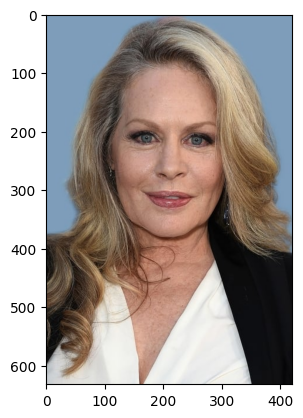

{'adult': False, 'also_known_as': '[]', 'biography': "Beverly D'Angelo (born November 15, 1951) is an American actress and singer.\n\nDescription above from the Wikipedia article Beverly D'Angelo, licensed under CC-BY-SA, full list of contributors on Wikipedia.", 'birthday': '1951-11-15', 'deathday': None, 'gender': 1, 'homepage': None, 'id': 821, 'imdb_id': 'nm0000350', 'known_for_department': 'Acting', 'name': "Beverly D'Angelo", 'place_of_birth': 'Columbus, Ohio, USA', 'popularity': 44.467, 'profile_path': '/8fYQIA8dAaA4GOTxOFSKIvTqzi.jpg', 'image': <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=421x632 at 0x28F26631250>}


In [3]:
idx = 100
plt.imshow(ds[idx]["image"])
plt.show()
print(ds[idx])

## Preprocessing

In [4]:
from torchvision import transforms
from PIL import Image

transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor(),
    transforms.Normalize([0.5], [0.5])
])

def transforms(examples):
    examples["pixel_values"] = [transform(image.convert("RGB")) for image in examples["image"]]
    return examples

ds = ds.with_transform(transforms)

In [5]:
from torch.utils.data import DataLoader
import torch

def collate_fn(exmaples):
    images = []
    labels = []
    for example in exmaples:
        images.append((example["pixel_values"]))
        labels.append(example["gender"])
    
    pixel_values = torch.stack(images)
    labels = torch.tensor(labels).long() - 1
    return {"pixel_values": pixel_values, "label": labels}

dataloader = DataLoader(ds, collate_fn=collate_fn, batch_size=4)

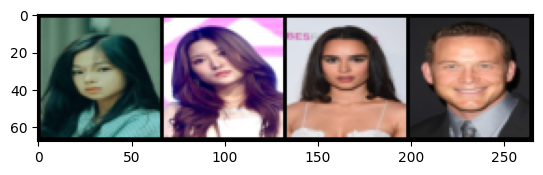

tensor([0, 0, 0, 1])


In [6]:
for batch in dataloader:
    print(batch["pixel_values"].shape)
    plt.imshow(torchvision.utils.make_grid(batch["pixel_values"]*0.5 + 0.5).permute(1, 2, 0).cpu().numpy())
    clear_output(wait=True)
    plt.show()
    print(batch["label"])
    break

## Use the Difusser Library

In [7]:
from diffusers import DDPMScheduler

scheduler = DDPMScheduler(beta_start=0.00085,
                          beta_end=0.012,
                          beta_schedule="scaled_linear",
                          num_train_timesteps=1000)

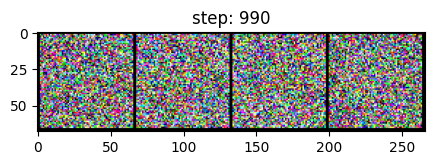

In [8]:
x = batch["pixel_values"]

for t in range(scheduler.num_train_timesteps):
    noise = torch.randn_like(x)

    x_noised = scheduler.add_noise(x, noise, torch.tensor(t).long())

    if t%10==0:
        plt.figure(figsize=(5, 5))
        plt.title(f"step: {t}")
        plt.imshow(torchvision.utils.make_grid(x_noised*0.5 + 0.5).permute(1, 2, 0).cpu().numpy())
        clear_output(wait=True)
        plt.show()

## The U-Net from the Diffusers Library

In [9]:
from diffusers import UNet2DModel

unet = UNet2DModel(
    sample_size=64,
    in_channels=3,
    out_channels=3,
    layers_per_block=2,

    down_block_types=("DownBlock2D", "AttnDownBlock2D", "AttnDownBlock2D", "AttnDownBlock2D"),
    mid_block_type="UNetMidBlock2D",
    up_block_types=("AttnUpBlock2D", "AttnUpBlock2D", "AttnUpBlock2D", "UpBlock2D"),
    block_out_channels=(64, 128, 160, 224),
    num_class_embeds=2
)

In [10]:
unet.to(device)

x = torch.randn(5, 3, 128, 128).to(device)
t = torch.linspace(0, 999, 5).long().to(device)
label = torch.tensor([0, 0, 1, 1, 1]).long().to(device)

with torch.no_grad():
    output = unet(x, t, label)

In [11]:
from diffusers import DDIMScheduler

def generate_image():
    xt = torch.randn(4, 3, 64, 64).to(device)
    label = torch.tensor([0, 0, 1, 1]).long().to(device)

    inf_scheduler = DDIMScheduler.from_config(scheduler.config)
    inf_scheduler.set_timesteps(50)

    unet.eval()

    for t in tqdm(inf_scheduler.timesteps, total=inf_scheduler.num_inference_steps, leave=False):
        with torch.no_grad():
            noise_pred = unet(xt, t.to(device), label).sample

        xt = inf_scheduler.step(noise_pred, t.to(device), xt).prev_sample
    
    plt.figure(figsize=(10, 3))
    plt.imshow(torchvision.utils.make_grid(xt*0.5 + 0.5).permute(1, 2, 0).cpu().numpy())
    plt.show()

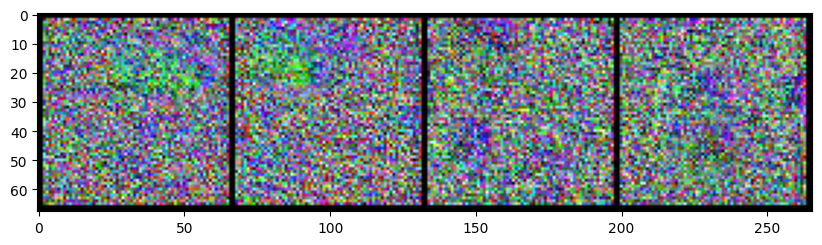

In [12]:
generate_image()

## Train the Diffusion Model

  0%|          | 1/249 [00:00<00:28,  8.77it/s]  

num_steps: 500, loss: 0.036727


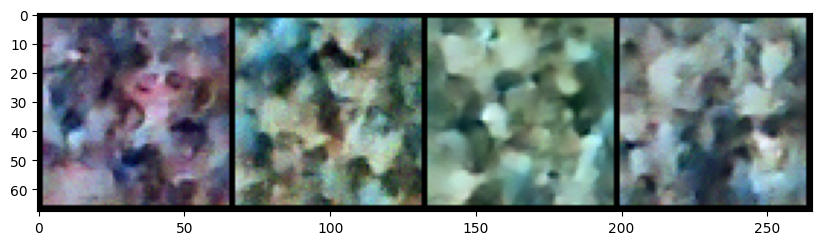

  1%|          | 3/249 [00:00<00:31,  7.78it/s]  

num_steps: 1000, loss: 0.031305


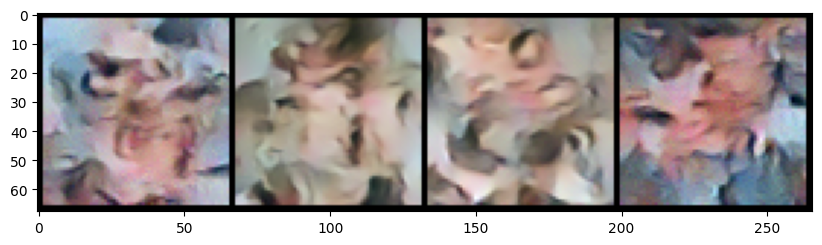

  2%|▏         | 5/249 [00:00<00:31,  7.63it/s]  

num_steps: 1500, loss: 0.030211


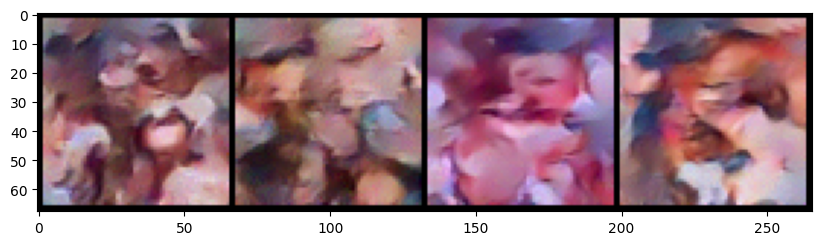

  3%|▎         | 7/249 [00:00<00:30,  7.92it/s]  

num_steps: 2000, loss: 0.027335


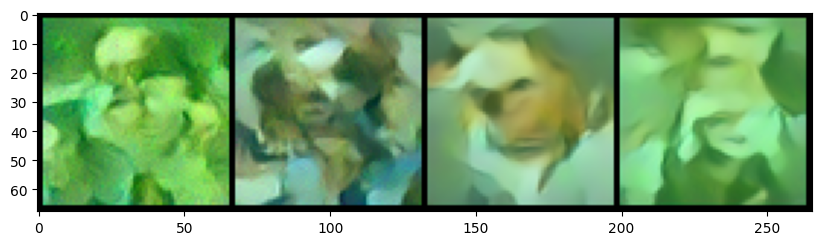

  4%|▎         | 9/249 [00:01<00:32,  7.50it/s]  

num_steps: 2500, loss: 0.024713


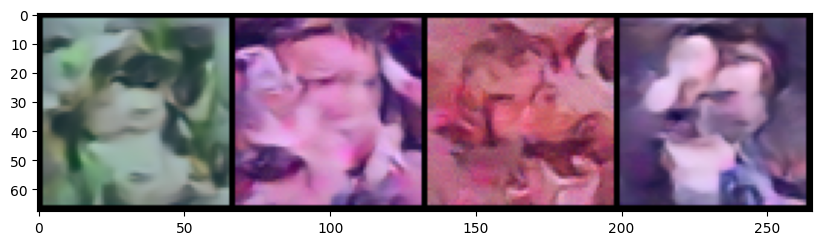

  4%|▍         | 11/249 [00:01<00:30,  7.73it/s] 

num_steps: 3000, loss: 0.022856


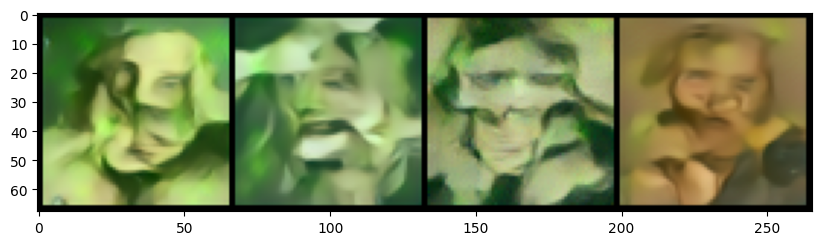

  5%|▌         | 13/249 [00:01<00:30,  7.73it/s] 

num_steps: 3500, loss: 0.024451


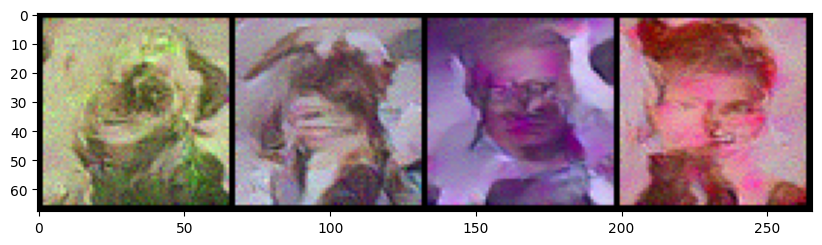

  6%|▌         | 15/249 [00:01<00:30,  7.73it/s] 

num_steps: 4000, loss: 0.025426


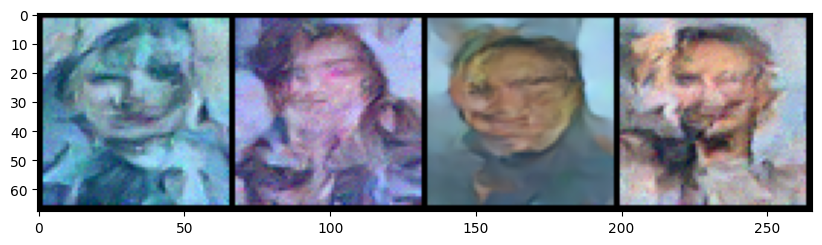

  7%|▋         | 17/249 [00:02<00:30,  7.61it/s] 

num_steps: 4500, loss: 0.025774


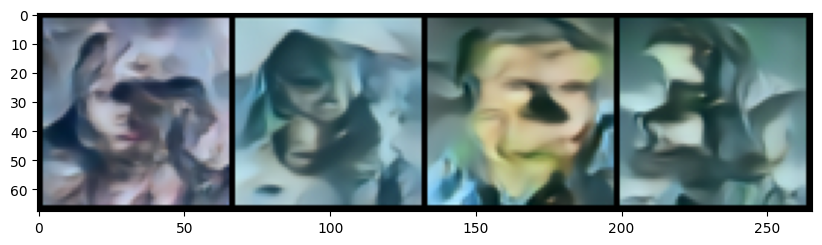

  8%|▊         | 19/249 [00:02<00:30,  7.65it/s] 

num_steps: 5000, loss: 0.024876


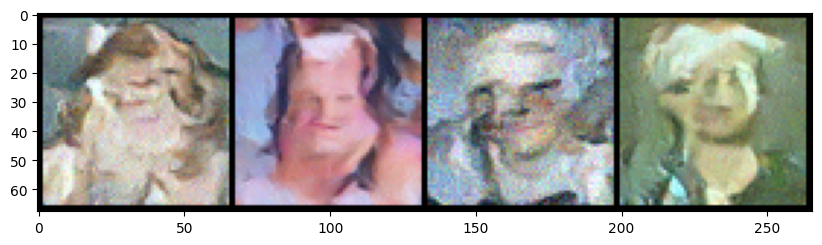

  8%|▊         | 21/249 [00:02<00:29,  7.73it/s] 

num_steps: 5500, loss: 0.019925


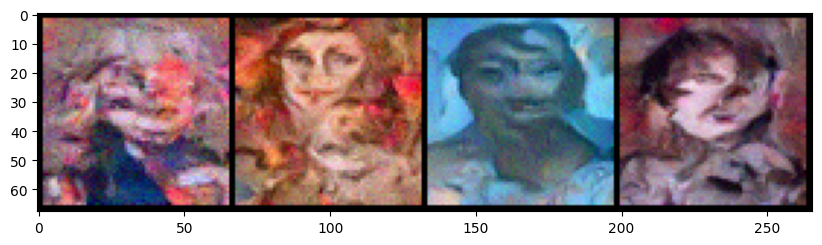

  9%|▉         | 23/249 [00:03<00:29,  7.69it/s] 

num_steps: 6000, loss: 0.024636


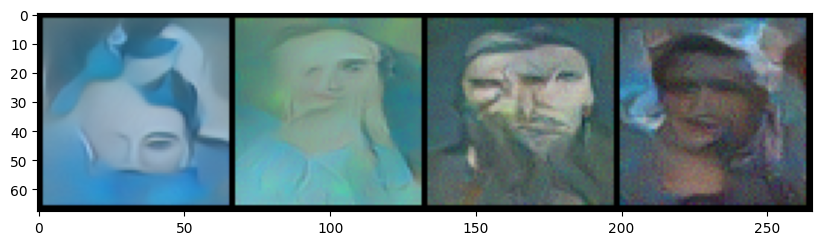

 10%|█         | 25/249 [00:03<00:29,  7.65it/s] 

num_steps: 6500, loss: 0.022212


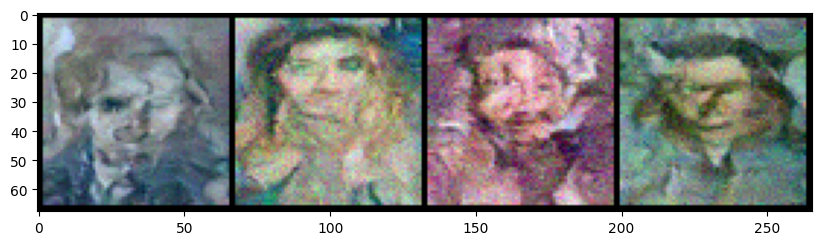

 11%|█         | 27/249 [00:03<00:28,  7.66it/s] 

num_steps: 7000, loss: 0.019428


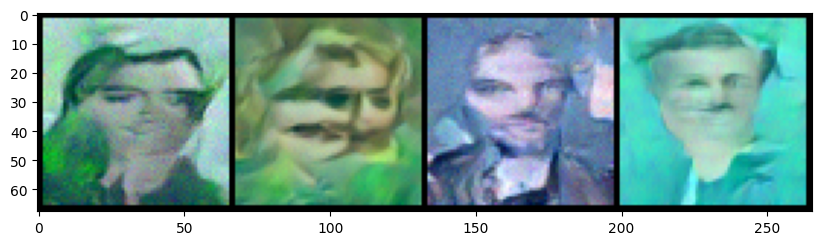

 12%|█▏        | 29/249 [00:03<00:28,  7.63it/s] 

num_steps: 7500, loss: 0.022933


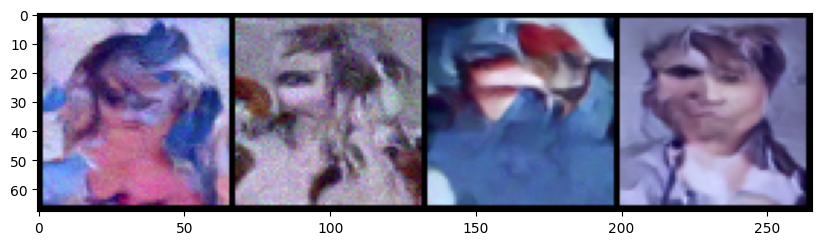

 12%|█▏        | 31/249 [00:04<00:29,  7.45it/s] 

num_steps: 8000, loss: 0.022475


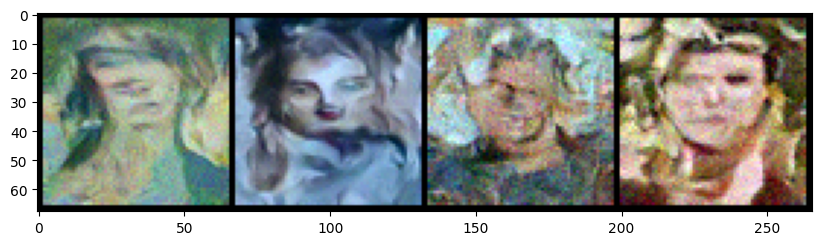

 13%|█▎        | 33/249 [00:04<00:28,  7.46it/s] 

num_steps: 8500, loss: 0.020023


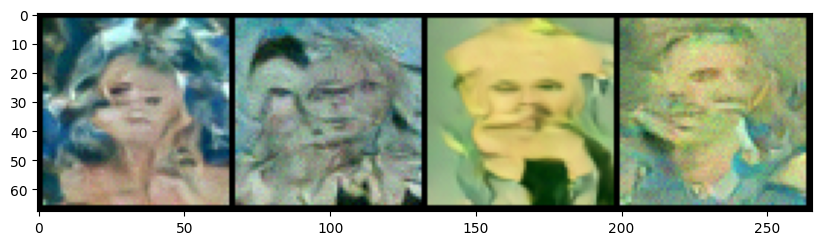

 14%|█▍        | 35/249 [00:04<00:27,  7.65it/s] 

num_steps: 9000, loss: 0.020756


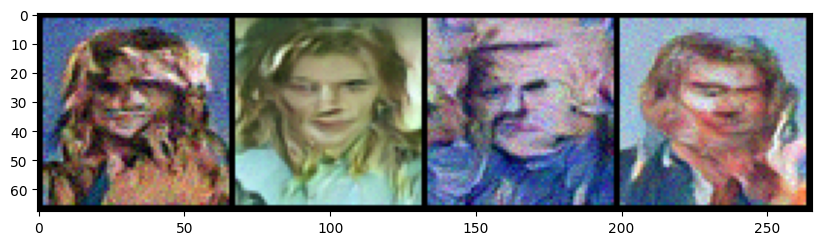

 15%|█▍        | 37/249 [00:04<00:28,  7.50it/s] 

num_steps: 9500, loss: 0.023456


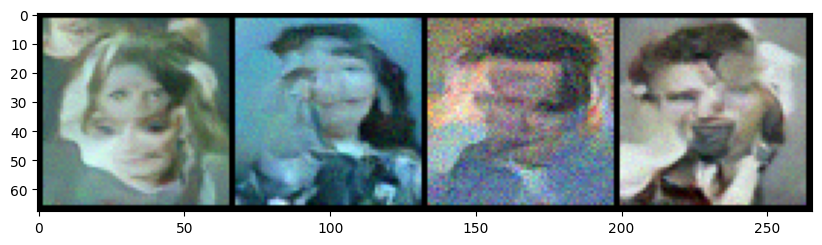

 16%|█▌        | 39/249 [00:05<00:27,  7.64it/s] 

num_steps: 10000, loss: 0.021100


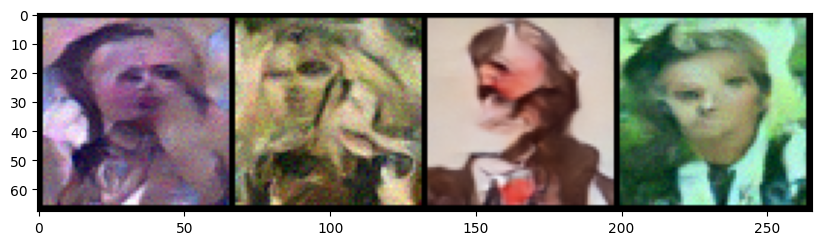

 16%|█▋        | 41/249 [00:05<00:26,  7.80it/s] 

num_steps: 10500, loss: 0.019371


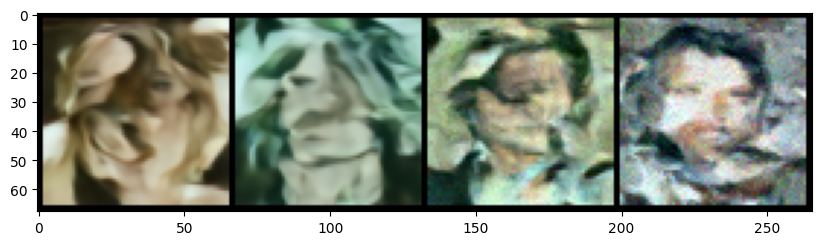

 17%|█▋        | 43/249 [00:05<00:27,  7.63it/s] 

num_steps: 11000, loss: 0.019046


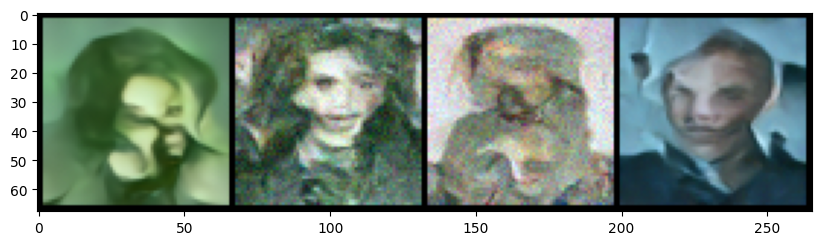

 18%|█▊        | 45/249 [00:05<00:26,  7.79it/s] 

num_steps: 11500, loss: 0.021301


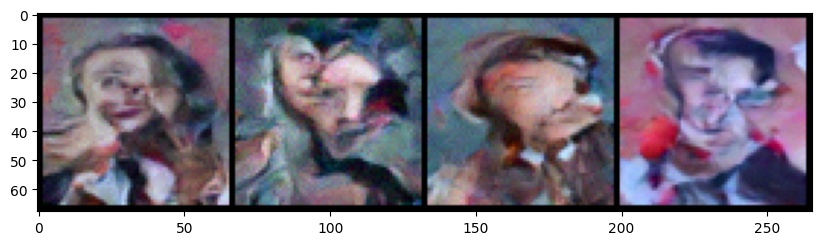

 19%|█▉        | 47/249 [00:06<00:26,  7.64it/s] 

num_steps: 12000, loss: 0.021190


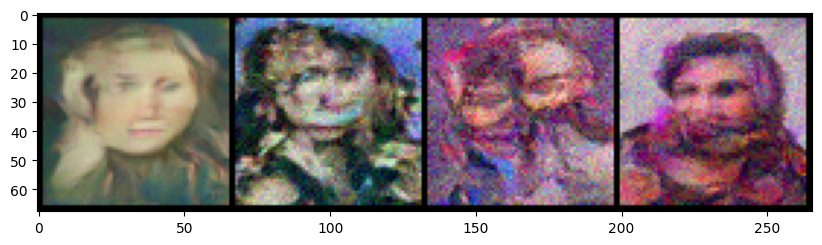

 20%|█▉        | 49/249 [00:06<00:26,  7.42it/s] 

num_steps: 12500, loss: 0.020122


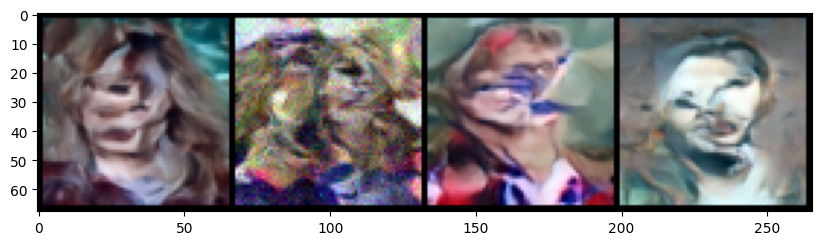

 20%|██        | 51/249 [00:06<00:25,  7.71it/s] 

num_steps: 13000, loss: 0.018513


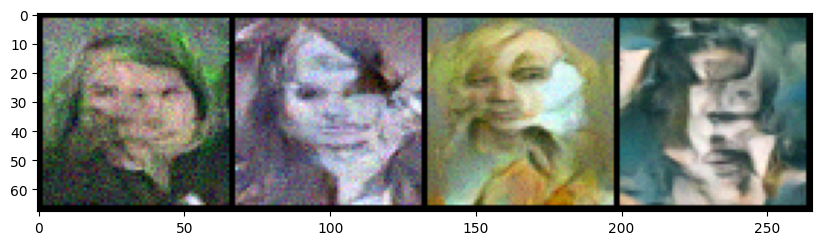

 21%|██▏       | 53/249 [00:06<00:25,  7.55it/s] 

num_steps: 13500, loss: 0.021705


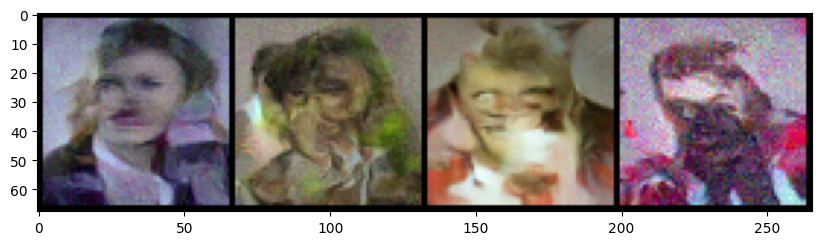

 22%|██▏       | 55/249 [00:07<00:25,  7.49it/s] 

num_steps: 14000, loss: 0.022831


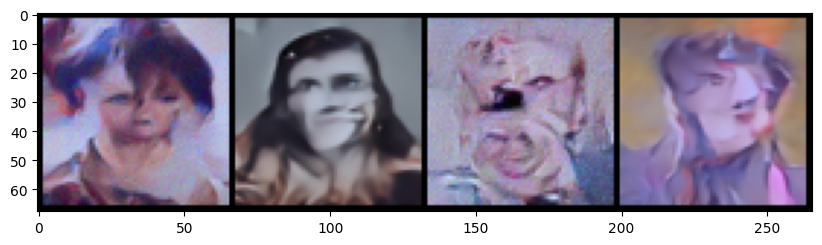

 23%|██▎       | 57/249 [00:07<00:25,  7.51it/s] 

num_steps: 14500, loss: 0.019914


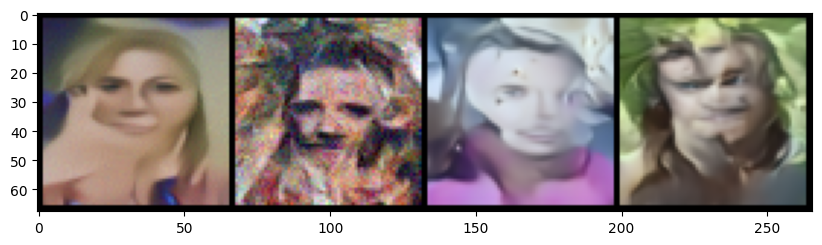

 24%|██▎       | 59/249 [00:07<00:24,  7.72it/s] 

num_steps: 15000, loss: 0.021086


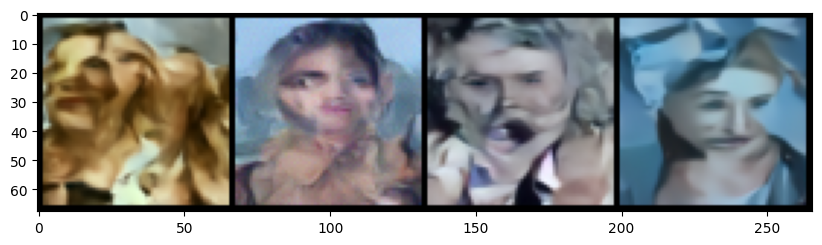

 24%|██▍       | 61/249 [00:08<00:24,  7.54it/s] 

num_steps: 15500, loss: 0.020970


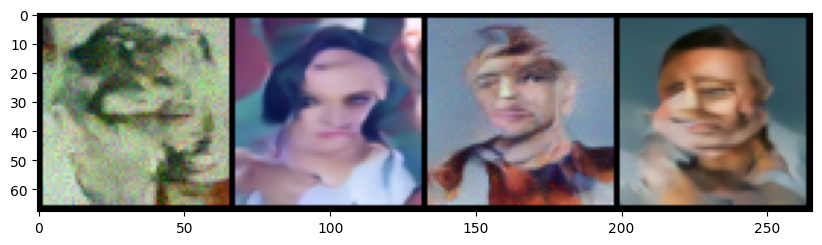

 25%|██▌       | 63/249 [00:08<00:24,  7.59it/s] 

num_steps: 16000, loss: 0.024386


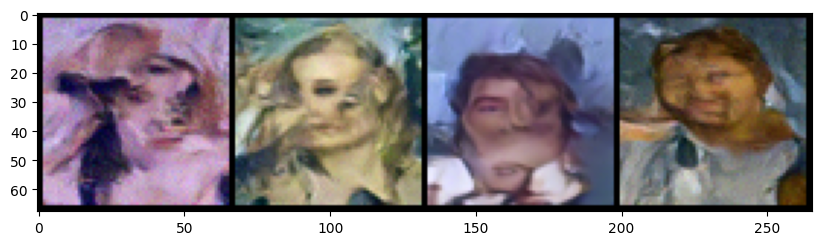

 26%|██▌       | 65/249 [00:09<00:24,  7.54it/s] 

num_steps: 16500, loss: 0.023261


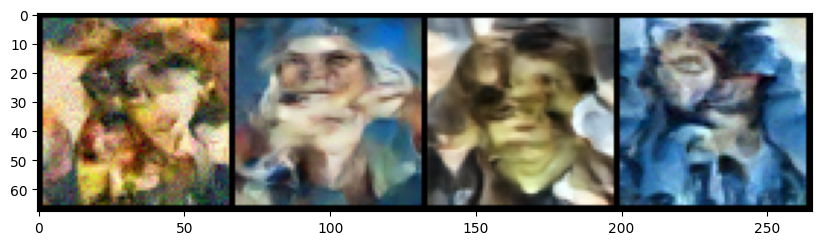

 27%|██▋       | 67/249 [00:08<00:23,  7.67it/s] 

num_steps: 17000, loss: 0.996967


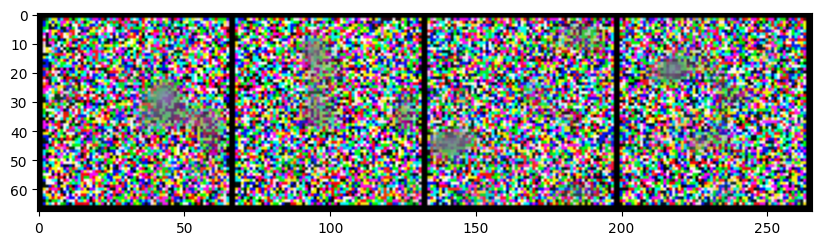

 28%|██▊       | 69/249 [00:08<00:23,  7.60it/s] 

num_steps: 17500, loss: 0.990671


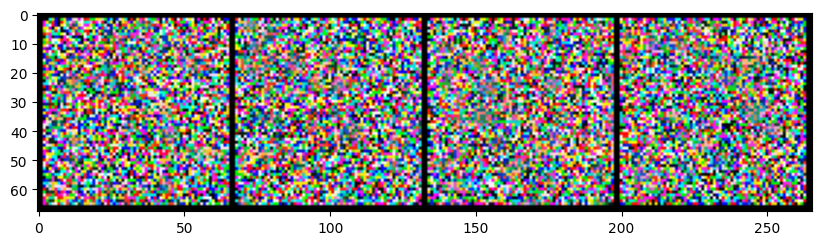

 29%|██▊       | 71/249 [00:09<00:23,  7.72it/s] 

num_steps: 18000, loss: 0.985990


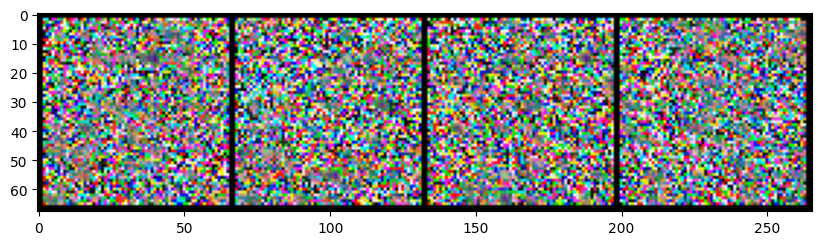

 29%|██▉       | 73/249 [00:09<00:23,  7.56it/s] 

num_steps: 18500, loss: 0.984078


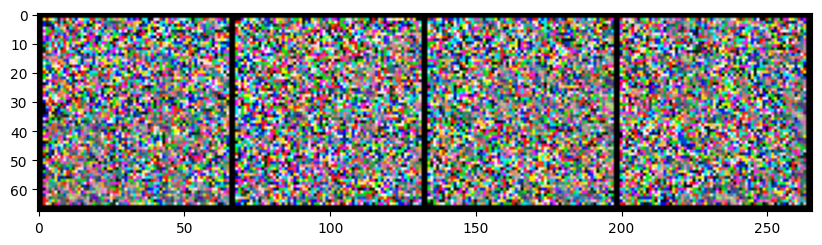

 30%|███       | 75/249 [00:09<00:22,  7.77it/s] 

num_steps: 19000, loss: 0.964441


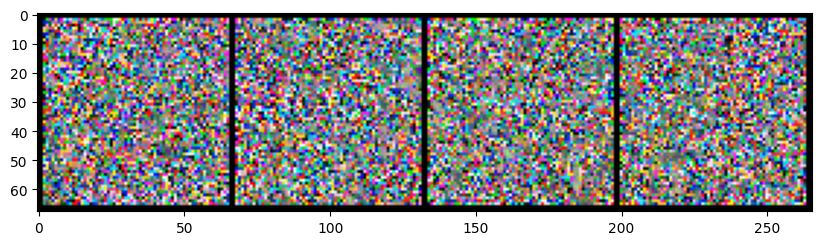

 31%|███       | 77/249 [00:10<00:22,  7.50it/s] 

num_steps: 19500, loss: 0.926521


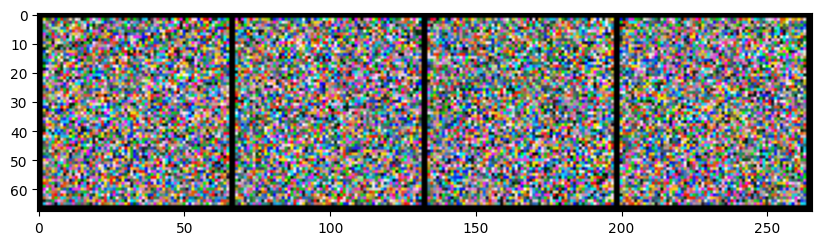

 32%|███▏      | 79/249 [00:10<00:22,  7.64it/s] 

num_steps: 20000, loss: 0.912603


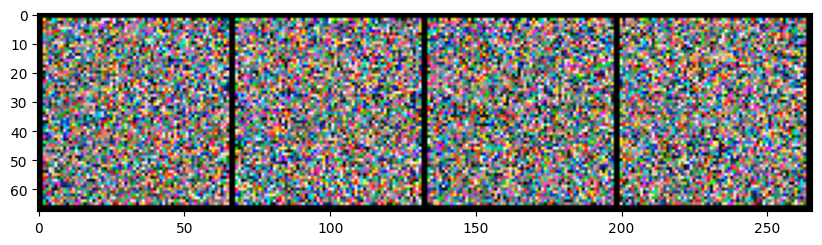

 33%|███▎      | 81/249 [00:10<00:22,  7.45it/s] 

num_steps: 20500, loss: 0.993693


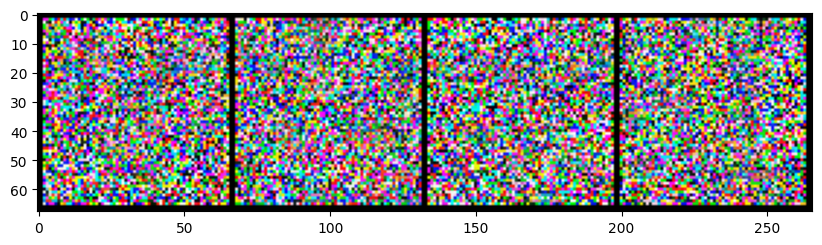

 33%|███▎      | 83/249 [00:10<00:21,  7.80it/s] 

num_steps: 21000, loss: 0.992690


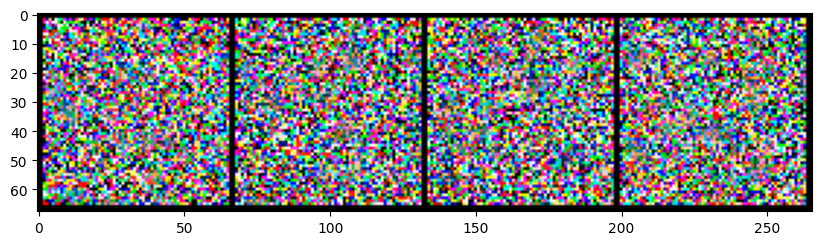

 34%|███▍      | 85/249 [00:11<00:21,  7.62it/s] 

num_steps: 21500, loss: 0.985541


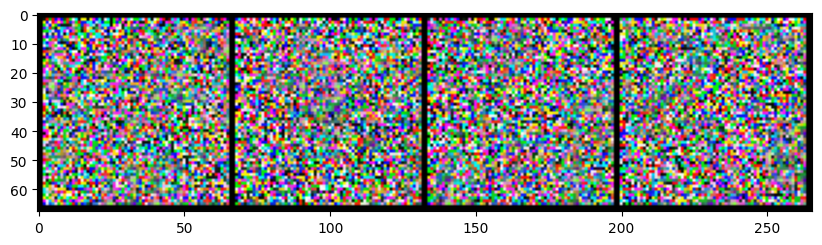

 35%|███▍      | 87/249 [00:11<00:21,  7.60it/s] 

num_steps: 22000, loss: 0.928878


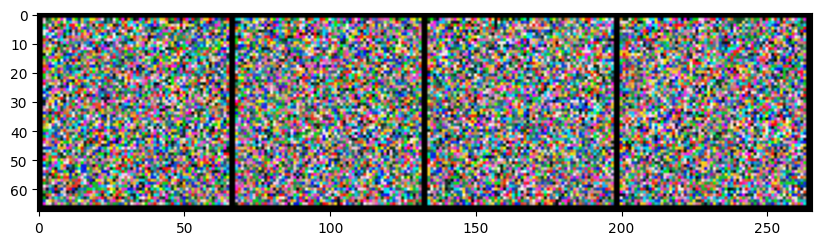

 36%|███▌      | 89/249 [00:11<00:21,  7.61it/s] 

num_steps: 22500, loss: 0.902981


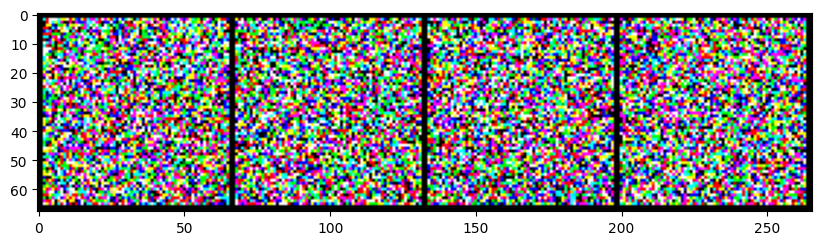

 37%|███▋      | 91/249 [00:11<00:20,  7.54it/s] 

num_steps: 23000, loss: 0.998712


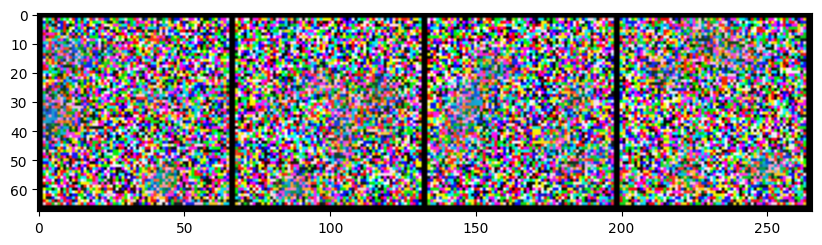

 37%|███▋      | 93/249 [00:12<00:20,  7.46it/s] 

num_steps: 23500, loss: 0.991947


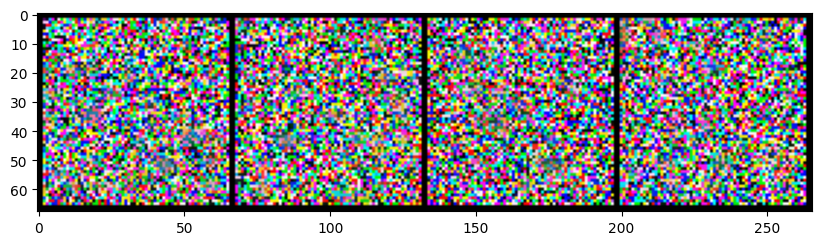

 38%|███▊      | 95/249 [00:12<00:20,  7.46it/s] 

num_steps: 24000, loss: 0.991059


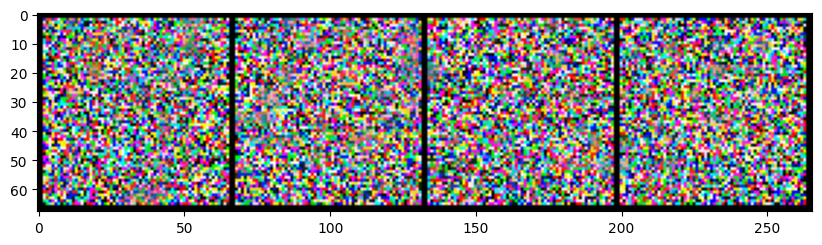

 39%|███▉      | 97/249 [00:12<00:19,  7.82it/s] 

num_steps: 24500, loss: 0.991353


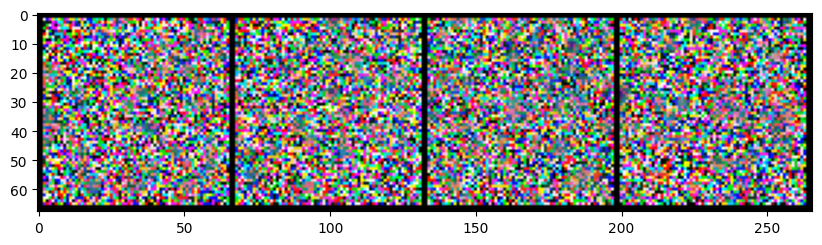

 40%|███▉      | 99/249 [00:12<00:19,  7.58it/s] 

num_steps: 25000, loss: 0.987394


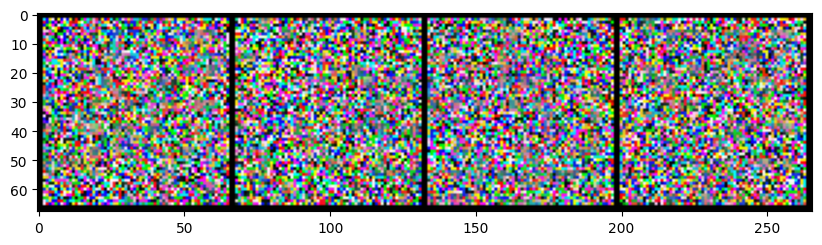

 41%|████      | 101/249 [00:13<00:20,  7.39it/s]

num_steps: 25500, loss: 0.982007


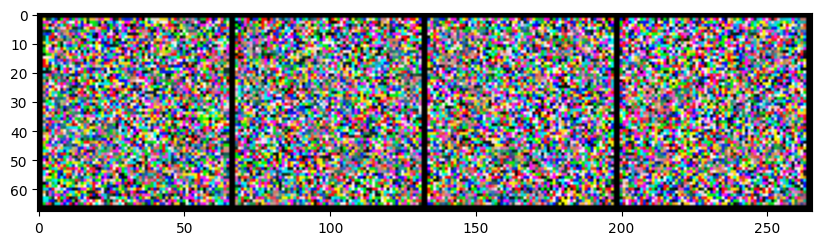

 41%|████▏     | 103/249 [00:13<00:18,  7.75it/s]

num_steps: 26000, loss: 0.980734


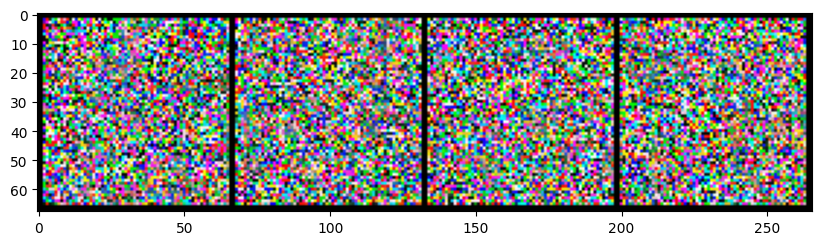

 42%|████▏     | 105/249 [00:13<00:18,  7.61it/s]

num_steps: 26500, loss: 0.980729


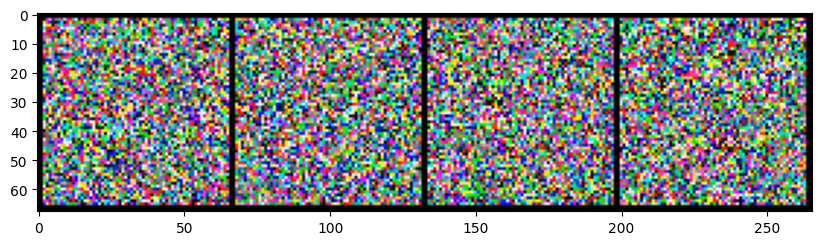

 43%|████▎     | 107/249 [00:14<00:18,  7.60it/s]

num_steps: 27000, loss: 0.980948


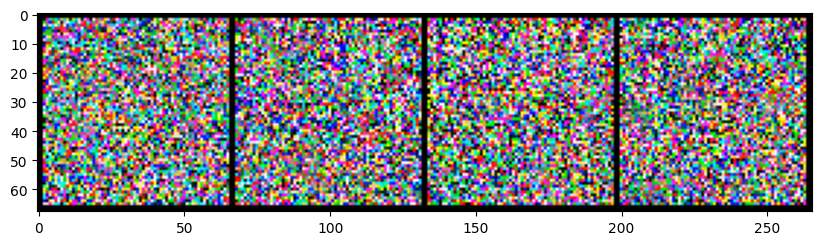

 44%|████▍     | 109/249 [00:14<00:18,  7.63it/s]

num_steps: 27500, loss: 0.980708


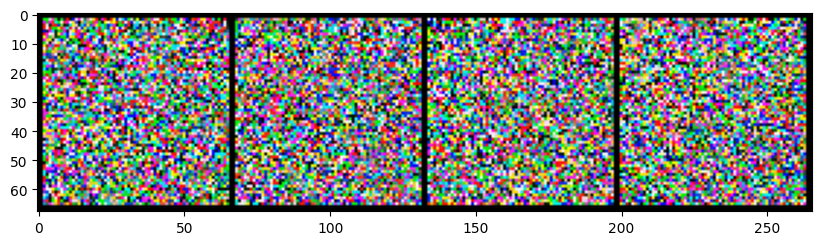

 45%|████▍     | 111/249 [00:14<00:17,  7.70it/s]

num_steps: 28000, loss: 0.972830


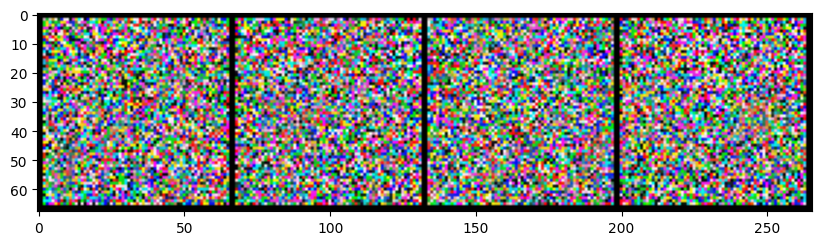

 45%|████▌     | 113/249 [00:14<00:17,  7.78it/s]

num_steps: 28500, loss: 0.863174


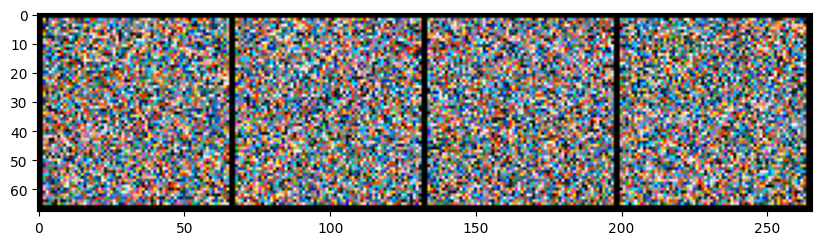

 46%|████▌     | 115/249 [00:15<00:17,  7.51it/s]

num_steps: 29000, loss: 0.917560


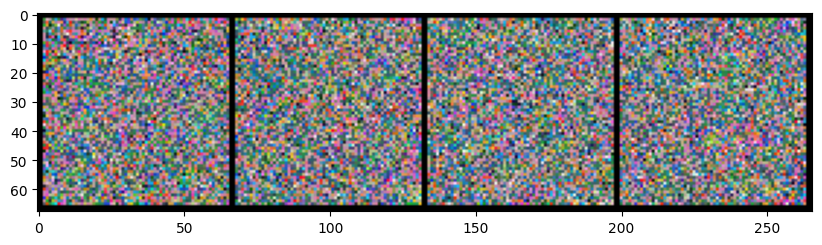

 47%|████▋     | 117/249 [00:15<00:17,  7.58it/s]

num_steps: 29500, loss: 0.999335


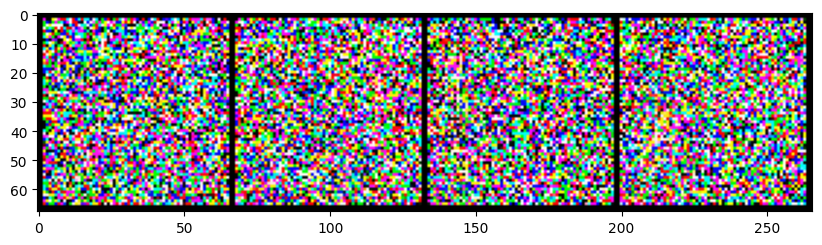

 48%|████▊     | 119/249 [00:15<00:17,  7.56it/s]

num_steps: 30000, loss: 0.989608


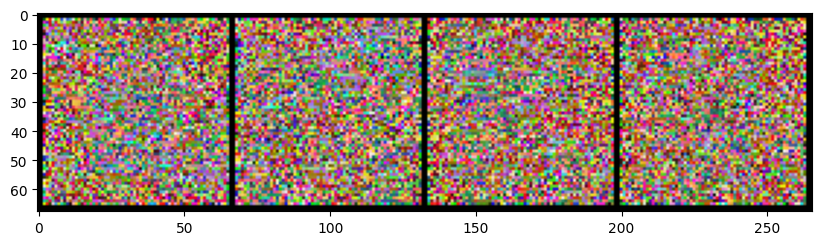

 49%|████▊     | 121/249 [00:16<00:17,  7.49it/s]

num_steps: 30500, loss: 0.958992


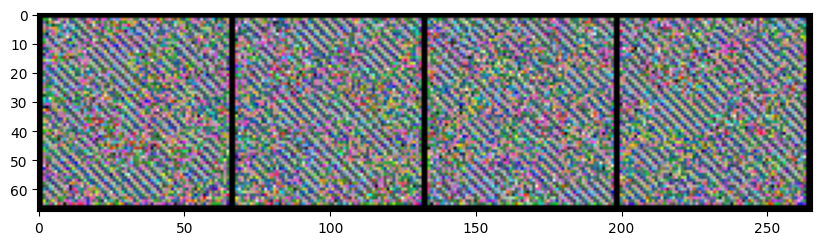

 49%|████▉     | 123/249 [00:16<00:16,  7.60it/s]

num_steps: 31000, loss: 0.584625


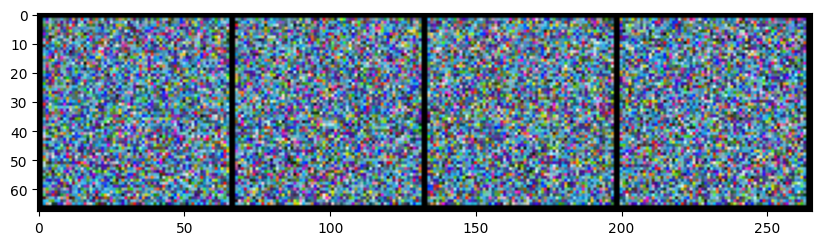

 50%|█████     | 125/249 [00:16<00:16,  7.65it/s]

num_steps: 31500, loss: 0.538432


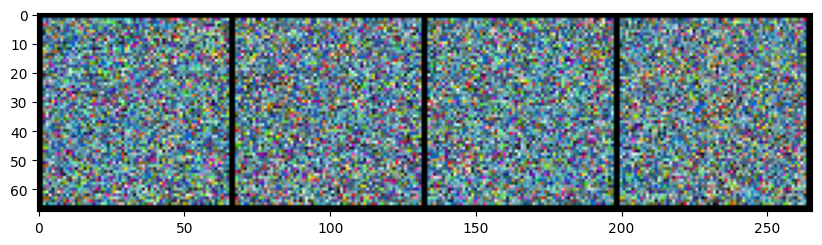

 51%|█████     | 127/249 [00:28<00:30,  3.99it/s]

num_steps: 32000, loss: 0.578986


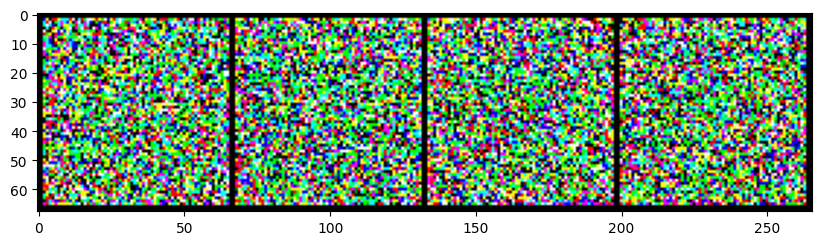

 52%|█████▏    | 129/249 [00:38<00:35,  3.40it/s]

num_steps: 32500, loss: 0.992501


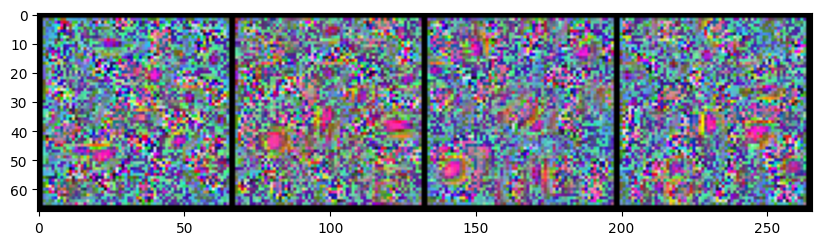

 53%|█████▎    | 131/249 [00:41<00:37,  3.16it/s]

num_steps: 33000, loss: 0.999427


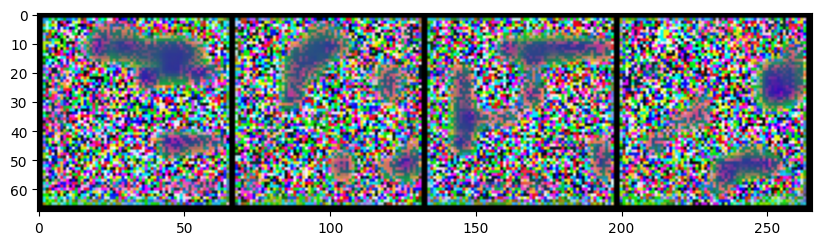

 53%|█████▎    | 133/249 [00:40<00:35,  3.29it/s]

num_steps: 33500, loss: 0.982759


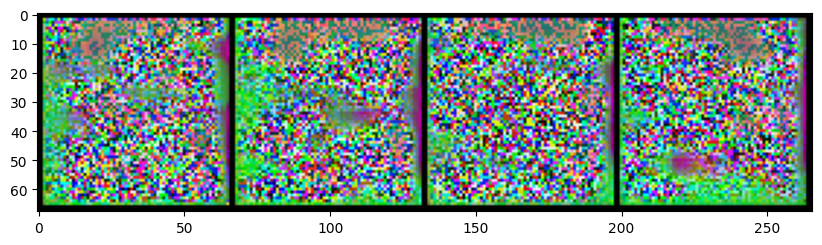

 54%|█████▍    | 135/249 [00:41<00:35,  3.19it/s]

num_steps: 34000, loss: 0.998393


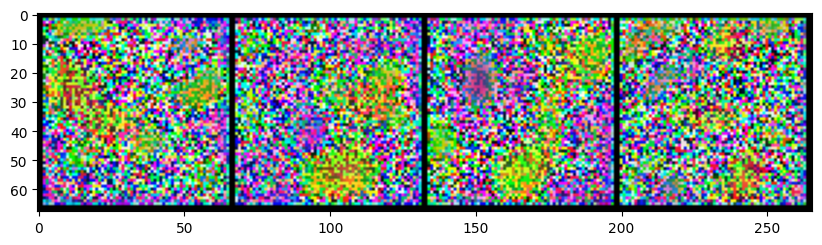

 55%|█████▌    | 137/249 [00:37<00:36,  3.09it/s]

num_steps: 34500, loss: 0.995981


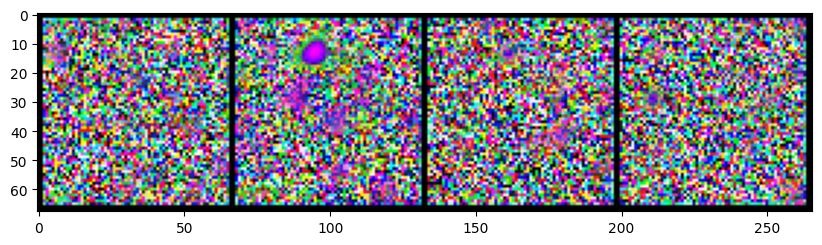

 56%|█████▌    | 139/249 [00:48<00:38,  2.84it/s]

num_steps: 35000, loss: 0.993649


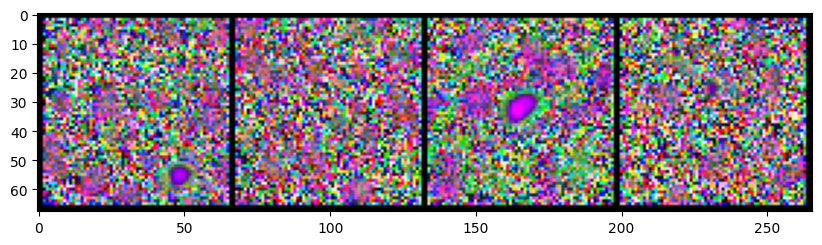

 57%|█████▋    | 141/249 [00:50<00:38,  2.80it/s]

num_steps: 35500, loss: 0.984234


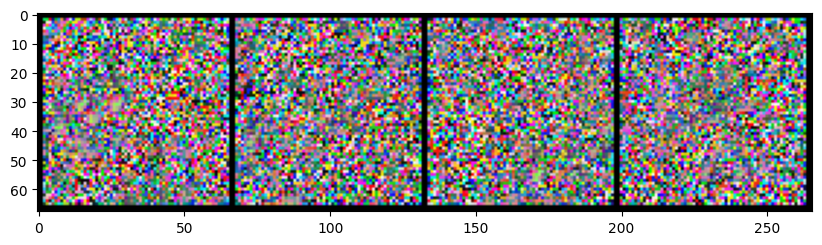

KeyboardInterrupt: 

In [ ]:
import torch
import torch.nn as nn

loss_fn = nn.MSELoss()
opt = torch.optim.Adam(unet.parameters(), lr=1e-3)

losses = []
num_steps = 0

while num_steps < 50000:
    for batch in tqdm(dataloader, total=len(dataloader), leave=False):

        # Forward diffusion
        x = batch["pixel_values"].to(device)
        y = batch["label"].long().to(device)
        noise = torch.randn_like(x)
        timesteps = torch.randint(0, 999, (x.shape[0],)).long().to(device)
        noisy_x = scheduler.add_noise(x, noise, timesteps)

        # Reverse diffusion
        pred = unet(noisy_x, timesteps, y).sample

        loss = loss_fn(pred, noise)

        opt.zero_grad()
        loss.backward()
        opt.step()

        num_steps += 1

        losses.append(loss)

        if num_steps%5 == 0:
            avg_loss = sum(losses[-100:])/100
            print(f"num_steps: {num_steps}, loss: {avg_loss:05f}")
            generate_image()